## CRISP(Cross Industry Standard Process)


_1.İş Anlayışı;_ Olimpiyat verileri üzerinde Zaman Serisi Analizi Çalışması;

_2.Veriyi Anlamak;_

                  •Veri seti Atina 1896'dan Rio 2016'ya kadar olan 120 yıllık tüm olimpiyat oyunlarının katılımıcılarının özelliklerini içermektedir.Bu veri içerisinde;

                  •Kış ve Yaz Oyunlarının 1992'ye kadar aynı yılda yapılmıştır. 92'den sonra, Kış Oyunları 1994'ten başlayarak dört yıllık bir döngüde, ardından 1996'da Yaz, ardından 1998'de Kış vb bir periyod ile yapılmaya devam etmektedir.

                  •Bir dönem şiir ve resim gibi sanat yarışmaları da olimpiyat oyunlarında yer almıştır.
     
               
_3.Verinin Hazırlanmas;_      

                   • Eksik Gözlem(Missing value), 
                   • Aykırı değer,
                   • Gürültülü veri.
_4.Modelleme;_

_5.Değerlendirme;_

_6.Kullanıma Sokma;_

In [1]:
# import;
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings 
import itertools
import statsmodels.api as sm
warnings.filterwarnings("ignore")

import os

from statsmodels.tsa.stattools import adfuller
from pmdarima import auto_arima
from pandas.plotting import autocorrelation_plot

from sklearn.metrics import mean_squared_error
from math import sqrt

from statsmodels.tsa.arima.model import ARIMA

In [2]:
!pip install pmdarima

In [3]:
data= pd.read_csv('./athlete_events.csv')
data.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN


In [4]:
data.tail()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
271111,135569,Andrzej ya,M,29.0,179.0,89.0,Poland-1,POL,1976 Winter,1976,Winter,Innsbruck,Luge,Luge Mixed (Men)'s Doubles,NaN
271112,135570,Piotr ya,M,27.0,176.0,59.0,Poland,POL,2014 Winter,2014,Winter,Sochi,Ski Jumping,"Ski Jumping Men's Large Hill, Individual",NaN
271113,135570,Piotr ya,M,27.0,176.0,59.0,Poland,POL,2014 Winter,2014,Winter,Sochi,Ski Jumping,"Ski Jumping Men's Large Hill, Team",NaN
271114,135571,Tomasz Ireneusz ya,M,30.0,185.0,96.0,Poland,POL,1998 Winter,1998,Winter,Nagano,Bobsleigh,Bobsleigh Men's Four,NaN
271115,135571,Tomasz Ireneusz ya,M,34.0,185.0,96.0,Poland,POL,2002 Winter,2002,Winter,Salt Lake City,Bobsleigh,Bobsleigh Men's Four,NaN


## 2.Veriyi Anlamak

In [5]:
data.shape

(271116, 15)

In [6]:
kategorik_kolonlar = data.select_dtypes(include='object').columns

kategorik_kolonlar

Index(['Name', 'Sex', 'Team', 'NOC', 'Games', 'Season', 'City', 'Sport',
       'Event', 'Medal'],
      dtype='object')

In [7]:
sayisal_kolonlar = data.select_dtypes(include=['int64', 'float64']).columns

list(sayisal_kolonlar)

['ID', 'Age', 'Height', 'Weight', 'Year']

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271116 entries, 0 to 271115
Data columns (total 15 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ID      271116 non-null  int64  
 1   Name    271116 non-null  object 
 2   Sex     271116 non-null  object 
 3   Age     261642 non-null  float64
 4   Height  210945 non-null  float64
 5   Weight  208241 non-null  float64
 6   Team    271116 non-null  object 
 7   NOC     271116 non-null  object 
 8   Games   271116 non-null  object 
 9   Year    271116 non-null  int64  
 10  Season  271116 non-null  object 
 11  City    271116 non-null  object 
 12  Sport   271116 non-null  object 
 13  Event   271116 non-null  object 
 14  Medal   39783 non-null   object 
dtypes: float64(3), int64(2), object(10)
memory usage: 31.0+ MB


In [9]:
data.isna().sum() # Yaş, boy, kilo ve madalya değişkenleri içerisinde boş veriler bulunmaktadır.

ID             0
Name           0
Sex            0
Age         9474
Height     60171
Weight     62875
Team           0
NOC            0
Games          0
Year           0
Season         0
City           0
Sport          0
Event          0
Medal     231333
dtype: int64

In [10]:
sporlar = pd.unique(data.Sport)
print("Sporlar: {}".format(len(sporlar)))
sporlar[:]


Sporlar: 66


array(['Basketball', 'Judo', 'Football', 'Tug-Of-War', 'Speed Skating',
       'Cross Country Skiing', 'Athletics', 'Ice Hockey', 'Swimming',
       'Badminton', 'Sailing', 'Biathlon', 'Gymnastics',
       'Art Competitions', 'Alpine Skiing', 'Handball', 'Weightlifting',
       'Wrestling', 'Luge', 'Water Polo', 'Hockey', 'Rowing', 'Bobsleigh',
       'Fencing', 'Equestrianism', 'Shooting', 'Boxing', 'Taekwondo',
       'Cycling', 'Diving', 'Canoeing', 'Tennis', 'Modern Pentathlon',
       'Figure Skating', 'Golf', 'Softball', 'Archery', 'Volleyball',
       'Synchronized Swimming', 'Table Tennis', 'Nordic Combined',
       'Baseball', 'Rhythmic Gymnastics', 'Freestyle Skiing',
       'Rugby Sevens', 'Trampolining', 'Beach Volleyball', 'Triathlon',
       'Ski Jumping', 'Curling', 'Snowboarding', 'Rugby',
       'Short Track Speed Skating', 'Skeleton', 'Lacrosse', 'Polo',
       'Cricket', 'Racquets', 'Motorboating', 'Military Ski Patrol',
       'Croquet', 'Jeu De Paume', 'Roque', 'Al

In [11]:
# Madalya kazanan ülkeleri Altın Madalya sayısına göre Sıralama
data_inc = data.copy()
data_inc = pd.get_dummies(data_inc,columns=["Medal"])


data_inc[["Team","Medal_Bronze","Medal_Gold","Medal_Silver"]].groupby(["Team"],as_index=False).sum().sort_values(by="Medal_Gold",ascending=False)[:15]

,Team,Medal_Bronze,Medal_Gold,Medal_Silver
1095,United States,1233.0,2474.0,1512.0
976,Soviet Union,677.0,1058.0,716.0
398,Germany,678.0,679.0,627.0
506,Italy,484.0,535.0,508.0
412,Great Britain,572.0,519.0,582.0
361,France,577.0,455.0,518.0
1010,Sweden,507.0,451.0,476.0
476,Hungary,365.0,432.0,330.0
173,Canada,408.0,422.0,413.0
301,East Germany,263.0,369.0,309.0


In [12]:
madalyalar = pd.unique(data.Medal)
print("madalyalar: {}".format(len(madalyalar)))
madalyalar[:]

madalyalar: 4


array([nan, 'Gold', 'Bronze', 'Silver'], dtype=object)

In [13]:
# :'(

turkey_data = data[data["Team"] == "Turkey"]
medal_total = turkey_data["Medal"].isin(["Silver", "Bronze", "Gold"]).sum()

print("Turkey takımının Toplam madalya sayısı:", medal_total)

Turkey takımının Toplam madalya sayısı: 95


In [14]:
cinsiyet_adet=data.groupby(['Sex','Year']).count().reset_index()


line_colors = ["#f509ed",'#2986cc']  #https://www.color-hex.com/color/0a2e36
a=px.line(cinsiyet_adet,x="Year",y="Name",color='Sex',markers=True,color_discrete_sequence=line_colors,template = "none")
a.update_layout(plot_bgcolor = "whitesmoke",
    title="<b>Erkekler Vs Kadınlar Trend <b>",
    yaxis_title="Katılımcı sayısı",
    xaxis_title="Yıllar"
)
a.show()

In [15]:
print(f"Ortalama Yaş: {round(data.Age.mean(),2)}", f"Yaşın Medyanı: {round(data.Age.median(),2)}", f"Yaşın Standart Sapması: {round(data.Age.std(),2)}", sep='\n')
print('\n')
print(f"Ortalama Boy: {round(data.Height.mean(),2)}", f"Boyun Medyanı: {round(data.Height.median(),2)}", f"Boyun Standat Sapması: {round(data.Height.std(),2)}", sep='\n')
print('\n')
print(f"Ortalam Kilo: {round(data.Weight.mean(),2)}", f"Kilonun Medyanı: {round(data.Weight.median(),2)}", f"Ağırlığın Standart Sapması: {round(data.Weight.std(),2)}", sep='\n')

Ortalama Yaş: 25.56
Yaşın Medyanı: 24.0
Yaşın Standart Sapması: 6.39


Ortalama Boy: 175.34
Boyun Medyanı: 175.0
Boyun Standat Sapması: 10.52


Ortalam Kilo: 70.7
Kilonun Medyanı: 70.0
Ağırlığın Standart Sapması: 14.35


_Yaz ve Kış Sezonları Sporcu Katılımları_

In [16]:
summer_data=data[(data['Season'] == 'Summer')]
winter_data=data[(data['Season'] == 'Winter')]

In [17]:
summer_men_data=summer_data[(summer_data['Sex'] == 'M')].groupby('Year')['Name'].count().reset_index()
summer_women_data=summer_data[(summer_data['Sex'] == 'F')].groupby('Year')['Name'].count().reset_index()

summer_mw_data = summer_men_data.merge(summer_women_data, on='Year')
summer_mw_data.rename(columns={"Name_x":"Male","Name_y":"Female"}, inplace=True)

In [18]:
winter_men_data=winter_data[(winter_data['Sex'] == 'M')].groupby('Year')['Name'].count().reset_index()
winter_women_data=winter_data[(winter_data['Sex'] == 'F')].groupby('Year')['Name'].count().reset_index()

winter_mw_data = winter_men_data.merge(winter_women_data, on='Year')
winter_mw_data.rename(columns={"Name_x":"Male","Name_y":"Female"}, inplace=True)

In [19]:
fig = px.line(summer_mw_data, x='Year', y=['Male', 'Female'], title='Summer Season', template='plotly_white')
fig.update_layout(yaxis_title="Sporcu Sayısı")
fig.show()

fig = px.line(winter_mw_data, x='Year', y=['Male', 'Female'], title='Winter Season', template='plotly_white')
fig.update_layout(yaxis_title="Sporcu Sayısı")
fig.show()

In [20]:
# En başarılı 20 sporcu ?
participants_with_medal = data[data["Medal"].notna()]
top_athletes = participants_with_medal.dropna(subset=["Medal"])
top_athletes = top_athletes.Name.value_counts().reset_index().head(20).merge(data,left_on="index",right_on="Name",how="left")\
                        [["index","Name_x","Sport","Team"]].drop_duplicates("index")
top_athletes.rename(columns={"index":"Name","Name_x":"Medals"},inplace=True)
top_athletes

,Name,Medals,Sport,Team
0,"Michael Fred Phelps, II",28,Swimming,United States
30,Larysa Semenivna Latynina (Diriy-),18,Gymnastics,Soviet Union
49,Nikolay Yefimovich Andrianov,15,Gymnastics,Soviet Union
73,Ole Einar Bjrndalen,13,Biathlon,Norway
100,Edoardo Mangiarotti,13,Fencing,Italy
114,Takashi Ono,13,Gymnastics,Japan
147,Borys Anfiyanovych Shakhlin,13,Gymnastics,Soviet Union
171,Paavo Johannes Nurmi,12,Athletics,Finland
183,"Jennifer Elisabeth ""Jenny"" Thompson (-Cumpelik)",12,Swimming,United States
200,"Dara Grace Torres (-Hoffman, -Minas)",12,Swimming,United States


In [21]:
fig = px.bar(top_athletes, x='Medals', y='Name', color = 'Team', color_discrete_sequence=px.colors.qualitative.Antique)
fig.show()

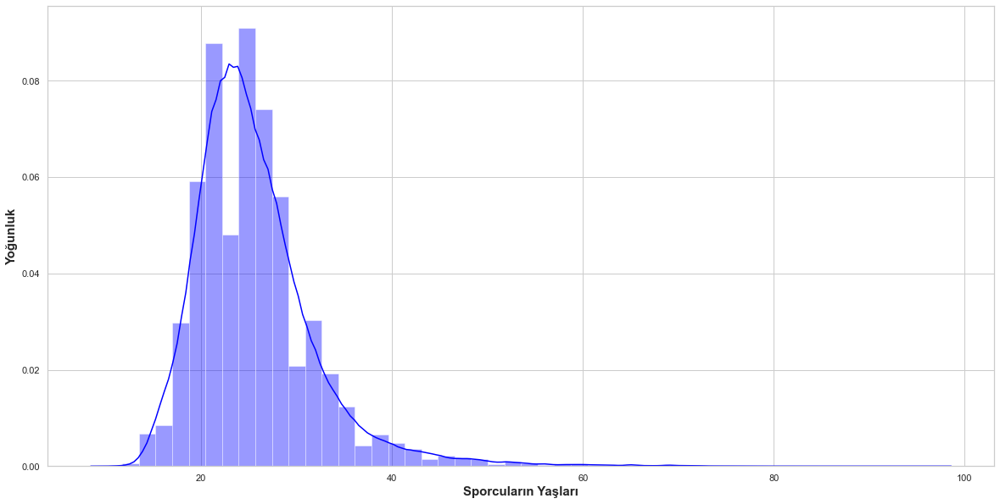

In [22]:
# Sporcuların Yaş Aralıkları
plt.figure(figsize=(20,10))
sns.set(style='whitegrid',)
sns.distplot(data["Age"], color="blue")
plt.xlabel("Sporcuların Yaşları",fontsize=15, weight="semibold")
plt.ylabel("Yoğunluk",fontsize=15, weight="semibold")
plt.show()

In [23]:
# Madalyalara Göre Yaş Değeri Yoğunlukları
fig = px.box(participants_with_medal, x="Medal", y="Age", color = 'Medal', color_discrete_sequence = ["gold", "brown", "silver"], template='plotly_white')
fig.show()

In [24]:
# Takımlardaki ortalama Yaşın yıllar içerisindeki değişimi;
fig = px.scatter(participants_with_medal, x="Year", y="Age", color = 'Sex', marginal_y="violin",
                 trendline="ols", template="simple_white", width=1000, height=500)
fig.show()

In [25]:
# Takımların Sezona Göre başarı dağılımları
participants_with_medal_summer = participants_with_medal[(participants_with_medal['Season'] == 'Summer')]
participants_with_medal_winter = participants_with_medal[(participants_with_medal['Season'] == 'Winter')]

top_countries_summer = participants_with_medal_summer.dropna(subset=["Medal"])
top_countries_summer = top_countries_summer.Team.value_counts().reset_index().head(100).merge(data,left_on="index",right_on="Team",how="left")\
                        [["index","Team_x"]].drop_duplicates("index")
top_countries_summer.rename(columns={"index":"Team","Team_x":"Medals"},inplace=True)

top_countries_winter = participants_with_medal_winter.dropna(subset=["Medal"])
top_countries_winter = top_countries_winter.Team.value_counts().reset_index().head(100).merge(data,left_on="index",right_on="Team",how="left")\
                        [["index","Team_x"]].drop_duplicates("index")
top_countries_winter.rename(columns={"index":"Team","Team_x":"Medals"},inplace=True)

In [26]:
top_countries_summer.loc[top_countries_summer['Medals'] < 500, 'Team'] = 'Other countries'
fig = px.pie(top_countries_summer, values='Medals', names='Team', title = "Summer Season")
fig.show()

top_countries_winter.loc[top_countries_winter['Medals'] < 100, 'Team'] = 'Other countries'
fig = px.pie(top_countries_winter, values='Medals', names='Team', title = "Winter Season")
fig.show()

In [27]:
# Takımları detaylı inceleme
sport_for_team = participants_with_medal.groupby(['Team', 'Sport'])['Medal'].count().reset_index()
sport_for_team

,Team,Sport,Medal
0,A North American Team,Polo,4
1,Afghanistan,Taekwondo,2
2,Algeria,Athletics,9
3,Algeria,Boxing,6
4,Algeria,Judo,2
...,...,...,...
1823,Zambia,Athletics,1
1824,Zambia,Boxing,1
1825,Zimbabwe,Hockey,15
1826,Zimbabwe,Swimming,7


In [28]:
fig = px.sunburst(sport_for_team, path=['Team', 'Sport'], values='Medal', width=800, height=800)
fig.show()

In [29]:
# Yıl-Ülke-Spor 3D Detaylı Görünüm
fig = px.scatter_3d(participants_with_medal, x='Team', y='Sport', z='Year',
              color='Medal', color_discrete_sequence=['gold', 'brown', 'silver'], template='plotly_white')
fig.show()

In [30]:
# Detaylı Madalyalar-2 
fig = px.scatter(participants_with_medal, x = 'Weight', y = 'Height',color=participants_with_medal["Medal"], symbol= participants_with_medal['Sex'], 
                color_discrete_sequence=['gold', 'brown', 'silver'], template='plotly_white')
fig.show()

## 3.Verinin Hazırlanması

#### Eksik Gözlemlerin incelenmesi;

In [31]:
# Madalya  sütunundaki boş değerlere "did not win a medal" Yazdırdım.
data['Medal'].fillna('did not win a medal', inplace=True)
print(data)

            ID                      Name Sex   Age  Height  Weight  \
0            1                 A Dijiang   M  24.0   180.0    80.0   
1            2                  A Lamusi   M  23.0   170.0    60.0   
2            3       Gunnar Nielsen Aaby   M  24.0     NaN     NaN   
3            4      Edgar Lindenau Aabye   M  34.0     NaN     NaN   
4            5  Christine Jacoba Aaftink   F  21.0   185.0    82.0   
...        ...                       ...  ..   ...     ...     ...   
271111  135569                Andrzej ya   M  29.0   179.0    89.0   
271112  135570                  Piotr ya   M  27.0   176.0    59.0   
271113  135570                  Piotr ya   M  27.0   176.0    59.0   
271114  135571        Tomasz Ireneusz ya   M  30.0   185.0    96.0   
271115  135571        Tomasz Ireneusz ya   M  34.0   185.0    96.0   

                  Team  NOC        Games  Year  Season            City  \
0                China  CHN  1992 Summer  1992  Summer       Barcelona   
1          

In [32]:
data.isna().sum() 

ID            0
Name          0
Sex           0
Age        9474
Height    60171
Weight    62875
Team          0
NOC           0
Games         0
Year          0
Season        0
City          0
Sport         0
Event         0
Medal         0
dtype: int64

In [33]:
# Yaş bilgisi eksik değerleri cinsiyete göre ortalama ile doldurma;

# Cinsiyetlere göre yaşın ortalamasını hesaplama
ortalama_yas_erkek = data[data['Sex'] == 'M']['Age'].mean()
ortalama_yas_kadin =  data[data['Sex'] == 'F']['Age'].mean()

# Boş yaş değerlerini cinsiyete göre ortalama yaşlarla doldurma
data.loc[(data['Sex'] == 'M') & (data['Age'].isna()), 'Age'] = ortalama_yas_erkek
data.loc[(data['Sex'] == 'F') & (data['Age'].isna()), 'Age'] = ortalama_yas_kadin


print(data)

            ID                      Name Sex   Age  Height  Weight  \
0            1                 A Dijiang   M  24.0   180.0    80.0   
1            2                  A Lamusi   M  23.0   170.0    60.0   
2            3       Gunnar Nielsen Aaby   M  24.0     NaN     NaN   
3            4      Edgar Lindenau Aabye   M  34.0     NaN     NaN   
4            5  Christine Jacoba Aaftink   F  21.0   185.0    82.0   
...        ...                       ...  ..   ...     ...     ...   
271111  135569                Andrzej ya   M  29.0   179.0    89.0   
271112  135570                  Piotr ya   M  27.0   176.0    59.0   
271113  135570                  Piotr ya   M  27.0   176.0    59.0   
271114  135571        Tomasz Ireneusz ya   M  30.0   185.0    96.0   
271115  135571        Tomasz Ireneusz ya   M  34.0   185.0    96.0   

                  Team  NOC        Games  Year  Season            City  \
0                China  CHN  1992 Summer  1992  Summer       Barcelona   
1          

In [34]:
data.isna().sum() 

ID            0
Name          0
Sex           0
Age           0
Height    60171
Weight    62875
Team          0
NOC           0
Games         0
Year          0
Season        0
City          0
Sport         0
Event         0
Medal         0
dtype: int64

In [35]:
# Boy bilgisi eksik değerleri cinsiyete göre ortalama ile doldurma;

# Cinsiyetlere göre Boy ortalamasını hesaplama
ortalama_boy_erkek = data[data['Sex'] == 'M']['Height'].mean()
ortalama_boy_kadin =  data[data['Sex'] == 'F']['Height'].mean()

# Boş boy değerlerini cinsiyete göre ortalama boy ile doldurma
data.loc[(data['Sex'] == 'M') & (data['Height'].isna()), 'Height'] = ortalama_boy_erkek
data.loc[(data['Sex'] == 'F') & (data['Height'].isna()), 'Height'] = ortalama_boy_kadin


print(data)

            ID                      Name Sex   Age      Height  Weight  \
0            1                 A Dijiang   M  24.0  180.000000    80.0   
1            2                  A Lamusi   M  23.0  170.000000    60.0   
2            3       Gunnar Nielsen Aaby   M  24.0  178.858463     NaN   
3            4      Edgar Lindenau Aabye   M  34.0  178.858463     NaN   
4            5  Christine Jacoba Aaftink   F  21.0  185.000000    82.0   
...        ...                       ...  ..   ...         ...     ...   
271111  135569                Andrzej ya   M  29.0  179.000000    89.0   
271112  135570                  Piotr ya   M  27.0  176.000000    59.0   
271113  135570                  Piotr ya   M  27.0  176.000000    59.0   
271114  135571        Tomasz Ireneusz ya   M  30.0  185.000000    96.0   
271115  135571        Tomasz Ireneusz ya   M  34.0  185.000000    96.0   

                  Team  NOC        Games  Year  Season            City  \
0                China  CHN  1992 Sum

In [36]:
# Kilo bilgisi eksik değerleri cinsiyete göre ortalama ile doldurdum;

# Cinsiyetlere göre kilo ortalamasını hesaplama
ortalama_kilo_erkek = data[data['Sex'] == 'M']['Weight'].mean()
ortalama_kilo_kadin =  data[data['Sex'] == 'F']['Weight'].mean()

# Boş kilo değerlerini cinsiyete göre ortalama kilo ile doldurma
data.loc[(data['Sex'] == 'M') & (data['Weight'].isna()), 'Weight'] = ortalama_kilo_erkek
data.loc[(data['Sex'] == 'F') & (data['Weight'].isna()), 'Weight'] = ortalama_kilo_kadin


print(data)

            ID                      Name Sex   Age      Height     Weight  \
0            1                 A Dijiang   M  24.0  180.000000  80.000000   
1            2                  A Lamusi   M  23.0  170.000000  60.000000   
2            3       Gunnar Nielsen Aaby   M  24.0  178.858463  75.743677   
3            4      Edgar Lindenau Aabye   M  34.0  178.858463  75.743677   
4            5  Christine Jacoba Aaftink   F  21.0  185.000000  82.000000   
...        ...                       ...  ..   ...         ...        ...   
271111  135569                Andrzej ya   M  29.0  179.000000  89.000000   
271112  135570                  Piotr ya   M  27.0  176.000000  59.000000   
271113  135570                  Piotr ya   M  27.0  176.000000  59.000000   
271114  135571        Tomasz Ireneusz ya   M  30.0  185.000000  96.000000   
271115  135571        Tomasz Ireneusz ya   M  34.0  185.000000  96.000000   

                  Team  NOC        Games  Year  Season            City  \
0

In [37]:
data.isna().sum() # eksik gözlemleri ortalamalar ile doldurdum.

ID        0
Name      0
Sex       0
Age       0
Height    0
Weight    0
Team      0
NOC       0
Games     0
Year      0
Season    0
City      0
Sport     0
Event     0
Medal     0
dtype: int64

#### Aykırı değerlerin İncelenmesi;

In [38]:
from collections import Counter
def anomaliTespiti(df,ozellik):
    outlier_indices = []

    for c in ozellik:
        #1'st quadrant
        Q1 = np.percentile(df[c],25)
        #3rd quadrant
        Q3 = np.percentile(df[c],75)
        #Inter Quartile Range
        IQR = Q3 - Q1
        #aykırı için ek adım mik
        outlier_step = 1.5 * IQR
        #aykırı index tespiti
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        #indes depola
        outlier_indices.extend(outlier_list_col)
    
    #eşşiz aykırı değer bul
    outlier_indices = Counter(outlier_indices)

    multiple_outliers = list(i for i, v in outlier_indices.items() if v > 1)

    return multiple_outliers

In [39]:
veri_anomali = data.loc[anomaliTespiti(data,["Age","Weight","Height"])]
veri_anomali.Sport.value_counts()

Gymnastics              1349
Basketball               757
Athletics                437
Rowing                   379
Handball                 274
Water Polo               223
Volleyball               200
Swimming                 147
Shooting                 138
Sailing                  104
Judo                      81
Bobsleigh                 54
Wrestling                 52
Beach Volleyball          31
Figure Skating            26
Ice Hockey                25
Boxing                    24
Equestrianism             22
Weightlifting             21
Canoeing                  18
Fencing                   15
Baseball                  14
Cross Country Skiing      14
Archery                   14
Taekwondo                 13
Diving                    12
Tennis                    10
Hockey                     6
Curling                    6
Tug-Of-War                 5
Rugby Sevens               3
Speed Skating              3
Rhythmic Gymnastics        3
Biathlon                   3
Skeleton      

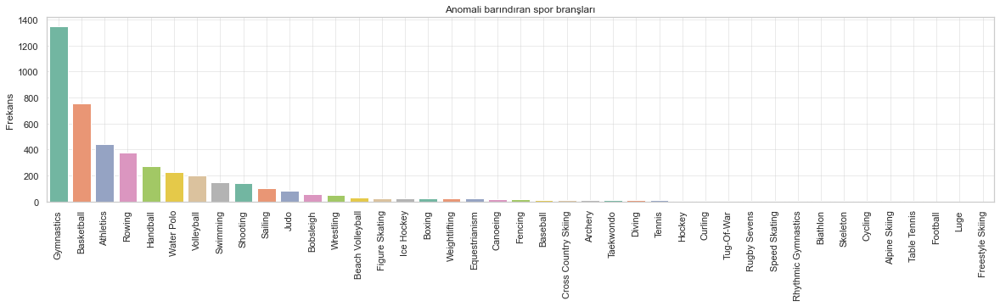

In [40]:
veri_anomali = data.loc[anomaliTespiti(data,list(sayisal_kolonlar))]
plt.figure(figsize=(20,4))
sns.barplot(x=veri_anomali.Sport.value_counts().index,y=veri_anomali.Sport.value_counts().values,data=veri_anomali,palette='Set2')
plt.xticks(rotation=90)
plt.title('Anomali barındıran spor branşları')
plt.ylabel('Frekans')
plt.grid(True,alpha=0.4)
plt.show()

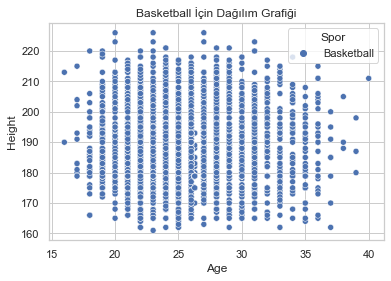

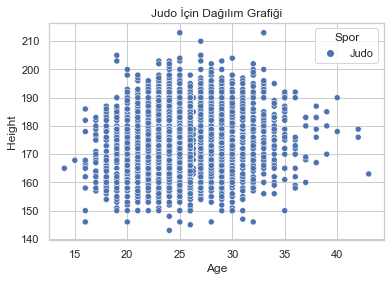

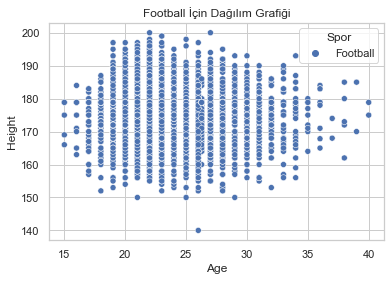

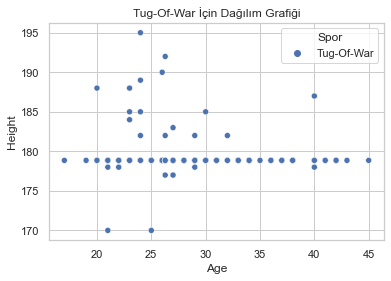

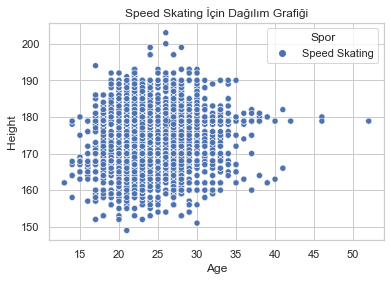

...

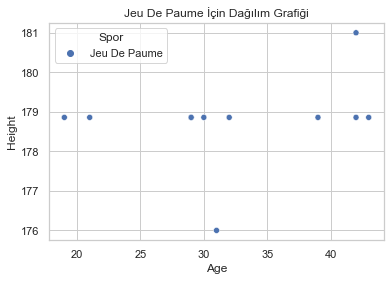

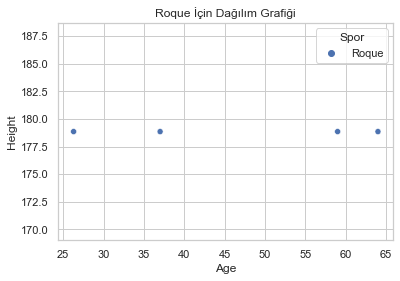

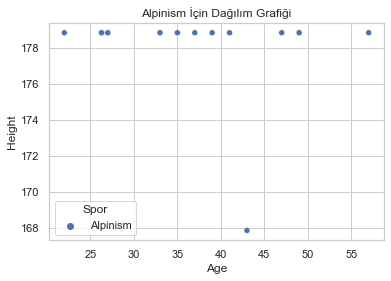

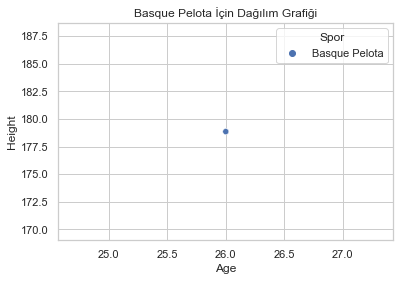

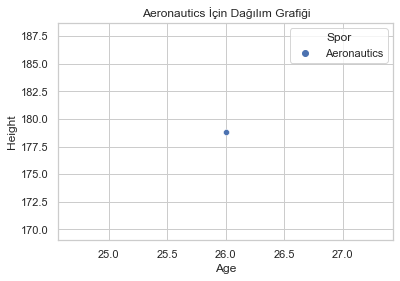

In [41]:
# Her Spor Dalı için Dağılım Grafiği;
unique_sports = data['Sport'].unique()

for sport in unique_sports:
    data_sport = data[data['Sport'] == sport]
    plt.figure() 
    sns.scatterplot(data=data_sport, x='Age', y='Height', hue='Sport')
    plt.title(f'{sport} İçin Dağılım Grafiği')
    plt.xlabel('Age')
    plt.ylabel('Height')
    plt.legend(title='Spor')  
    plt.show()


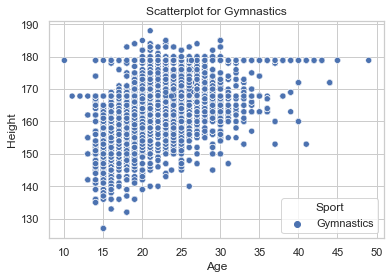

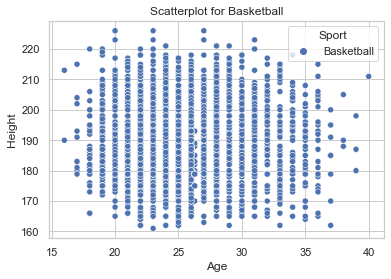

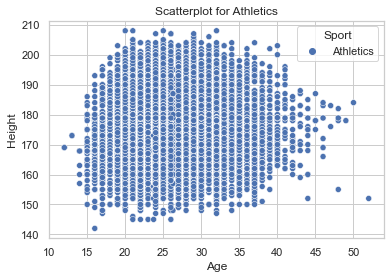

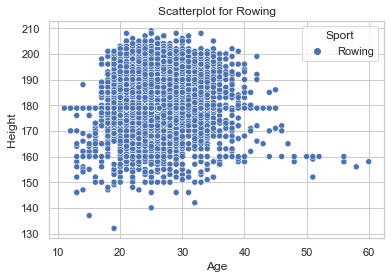

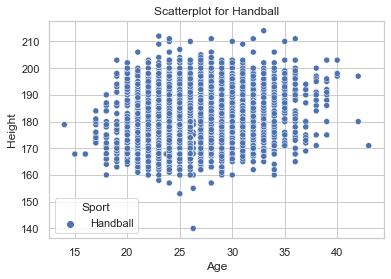

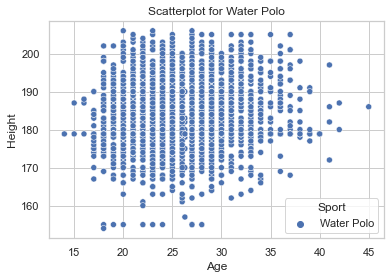

In [42]:
# Yaş için anomali inceleme;
anomali_sports = ["Gymnastics", "Basketball", "Athletics", "Rowing", "Handball","Water Polo"]

# Her bir anomali spor dalı için ayrı bir scatterplot oluşturdum.
for sport in anomali_sports:
    filtered_data = data[data['Sport'] == sport]  # Spor dalına göre verileri filtreledim
    sns.scatterplot(data=filtered_data, x="Age", y="Height", hue="Sport")
    plt.title(f'Scatterplot for {sport}')
    plt.show()

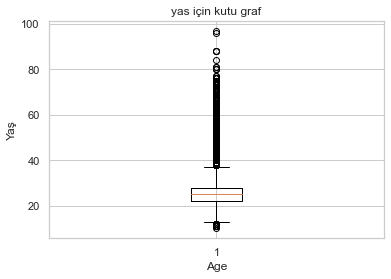

In [43]:
plt.boxplot(data.Age)
plt.title("yas için kutu graf")
plt.xlabel("Age")
plt.ylabel("Yaş")
plt.show()

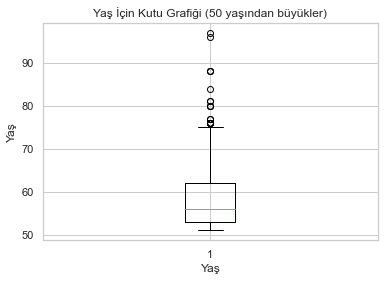

In [44]:
# 60 yaşından büyükleri filtreledim
age_filter = data['Age'] > 50
filtered_age_data = data[age_filter]

# Kutu grafiği oluşturun
plt.boxplot(filtered_age_data['Age'])
plt.title("Yaş İçin Kutu Grafiği (50 yaşından büyükler)")
plt.xlabel("Yaş")
plt.ylabel("Yaş")
plt.show()

In [45]:
# 60 yaşından büyükleri filtrelerim
age_filter = data['Age'] > 50
filtered_data = data[age_filter]

# Yaşları 50'dan büyük olan kişilerin spor dalları
spor_dallari = filtered_data['Sport']
spor_adetleri = filtered_data['Sport']

# Verileri bir tabloya dönüştürmek için 
spor_tablo = pd.DataFrame({'Sport': spor_dallari, 'Sport': spor_adetleri})

# Tabloyu yazdırın
print(spor_tablo)

                   Sport
58      Art Competitions
128             Shooting
129             Shooting
698             Shooting
699             Shooting
...                  ...
267815          Shooting
268567          Shooting
269857     Equestrianism
270199  Art Competitions
270200  Art Competitions

[1938 rows x 1 columns]


In [46]:
unique_spor_branslari = spor_tablo['Sport'].unique()
print("Benzersiz Spor Branşları:")
for spor_branşi in unique_spor_branslari:
    print(spor_branşi)

Benzersiz Spor Branşları:
Art Competitions
Shooting
Fencing
Equestrianism
Sailing
Archery
Rowing
Alpinism
Skeleton
Bobsleigh
Motorboating
Diving
Table Tennis
Luge
Curling
Roque
Modern Pentathlon
Polo
Figure Skating
Speed Skating
Alpine Skiing
Croquet
Athletics


In [47]:
#verisetinden Art Competitions içerenleri çıkartıyorum.
data = data[data['Sport'] != 'Art Competitions']

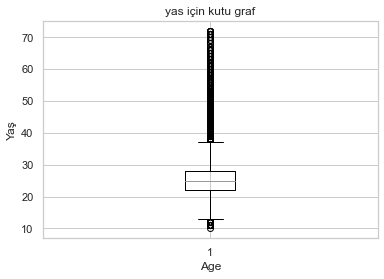

In [48]:
plt.boxplot(data.Age)
plt.title("yas için kutu graf")
plt.xlabel("Age")
plt.ylabel("Yaş")
plt.show()

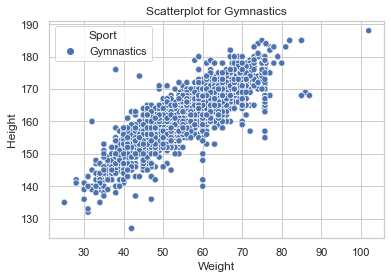

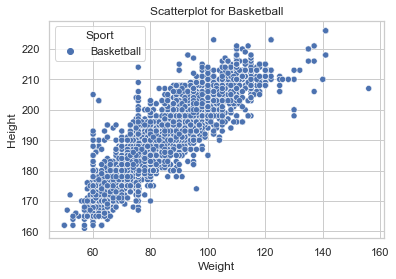

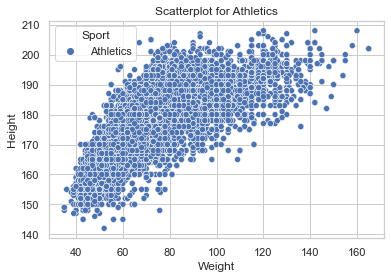

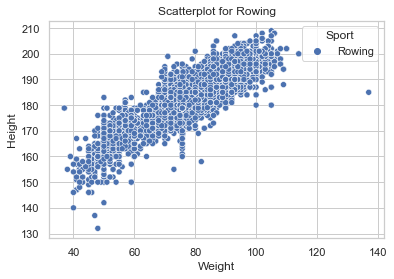

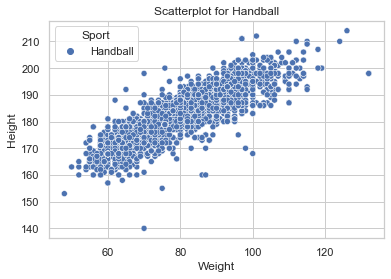

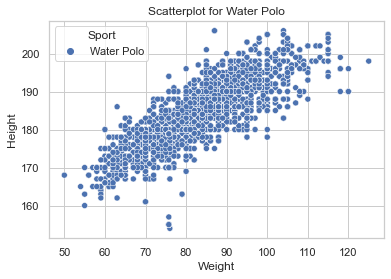

In [49]:
# Kilo için anomali inceleme; 
anomali_sports = ["Gymnastics", "Basketball", "Athletics", "Rowing", "Handball","Water Polo"]

# Her bir anomali spor dalı için ayrı bir scatterplot oluşturdum.
for sport in anomali_sports:
    filtered_data = data[data['Sport'] == sport]  # Spor dalına göre verileri filtreledim
    sns.scatterplot(data=filtered_data, x="Weight", y="Height", hue="Sport")
    plt.title(f'Scatterplot for {sport}')
    plt.show()

Aslında veri seti içerisinde anomali gösteren değerler kabul edilebilir seviyede çünkü; Jimnastikte meydana gelene anomalinin sebebi sporcuların yaşlarının küçük ve kilolarının çok az olabilmesinden, Basketbolda gözlenen anomalinin sebebi ise erkek basketbol oyuncularının boylarının çok uzun ve kilolarının da fazla olduğu gözlemlenmiştir. Bu yüzden veri seti içerisinde anomali frekansını azaltmak için veri manipülasyonu yapılmamıştır. sadece artık olimpiyatlara sanat braşlarının katılmamasından ve sanat dalında faaliyet gösteren katılımcı yaşları ve kiloları veri setinde gürültü yaratmasından kaynaklı bu branş veri setinden çıkartılmıştır.

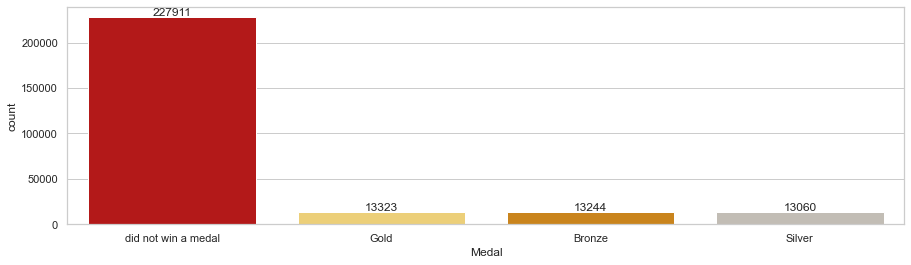

In [50]:
fig, ax=plt.subplots(1, figsize=(15,4))
sns.countplot(x=data.Medal,palette = ["#cc0000","#ffd966","#e68a00","#c4bdb3"])
ax.bar_label(ax.containers[0])
# Madalya dağılımı eşit sayılarda dağıtılmış diyebiliriz
plt.show()

In [51]:
duplicateRows = data[data.duplicated()]
duplicateRows.count()
# çift giriş yapılmış 1385 adet veri vardı, sildim.Bu 70 sporcu da farklı branşlardan katılım sağlayan aynı kişiler aslında..

ID        70
Name      70
Sex       70
Age       70
Height    70
Weight    70
Team      70
NOC       70
Games     70
Year      70
Season    70
City      70
Sport     70
Event     70
Medal     70
dtype: int64

In [52]:
# Yaz ve Kış için ayrı ayrı Filtreleme

yaz_data = data[data['Season'] == 'Summer']
kıs_data = data[data['Season'] == 'Winter']


yaz_cinsiyet_count = yaz_data.groupby(['Year', 'Sex'])['ID'].count().unstack()
kıs_cinsiyet_count = kıs_data.groupby(['Year', 'Sex'])['ID'].count().unstack()

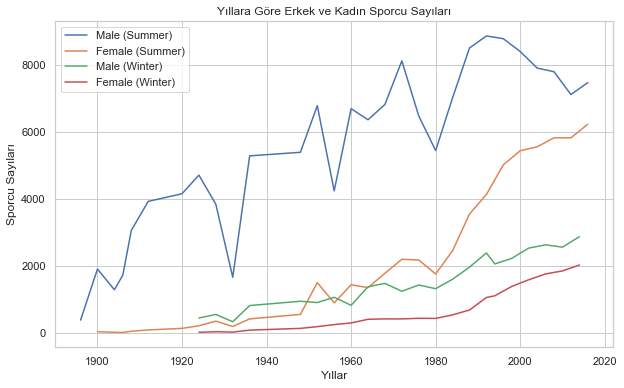

In [53]:
#Çizgi Grafik
plt.figure(figsize=(10, 6))
plt.plot(yaz_cinsiyet_count.index, yaz_cinsiyet_count['M'], label='Male (Summer)')
plt.plot(yaz_cinsiyet_count.index, yaz_cinsiyet_count['F'], label='Female (Summer)')
plt.plot(kıs_cinsiyet_count.index, kıs_cinsiyet_count['M'], label='Male (Winter)')
plt.plot(kıs_cinsiyet_count.index, kıs_cinsiyet_count['F'], label='Female (Winter)')

plt.xlabel('Yıllar')
plt.ylabel('Sporcu Sayıları')
plt.title('Yıllara Göre Erkek ve Kadın Sporcu Sayıları')
plt.legend()
plt.grid(True)
plt.show()

##### Zaman serisi analizine hazırlık
_İş problemimiz zaman serisi analizi olduğu için bazı sütunlarını silicem ve erkek sporcular ve kadın sporcular için ayrı zaman serisi incelemesi gerçekleştiricem._

In [54]:
data_new = data.copy()
data_new["Medal"].replace({
    "Gold": "Başarılı",
    "Silver": "Başarılı",
    "Bronze": "Başarılı",
    "did not win a medal": "Başarısız"
}, inplace=True)
data_new.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.000000,80.000000,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,Başarısız
1,2,A Lamusi,M,23.0,170.000000,60.000000,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,Başarısız
2,3,Gunnar Nielsen Aaby,M,24.0,178.858463,75.743677,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,Başarısız
3,4,Edgar Lindenau Aabye,M,34.0,178.858463,75.743677,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Başarılı
4,5,Christine Jacoba Aaftink,F,21.0,185.000000,82.000000,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,Başarısız


In [55]:
#ID ve Sporcu Name,Games, NOC, Event ve City Sütununu sildim.
data_new.drop(columns="ID",inplace=True)
data_new.drop(columns="Name",inplace=True)
data_new.drop(columns="Games",inplace=True)
data_new.drop(columns="NOC",inplace=True)
data_new.drop(columns="City",inplace=True)
data_new.drop(columns="Event",inplace=True)
data_new.head()

,Sex,Age,Height,Weight,Team,Year,Season,Sport,Medal
0,M,24.0,180.000000,80.000000,China,1992,Summer,Basketball,Başarısız
1,M,23.0,170.000000,60.000000,China,2012,Summer,Judo,Başarısız
2,M,24.0,178.858463,75.743677,Denmark,1920,Summer,Football,Başarısız
3,M,34.0,178.858463,75.743677,Denmark/Sweden,1900,Summer,Tug-Of-War,Başarılı
4,F,21.0,185.000000,82.000000,Netherlands,1988,Winter,Speed Skating,Başarısız


In [56]:
data_new_M = data_new[data_new['Sex'] == 'M']
data_new_F = data_new[data_new['Sex'] == 'F']

In [57]:
data_new_M.head()

,Sex,Age,Height,Weight,Team,Year,Season,Sport,Medal
0,M,24.0,180.000000,80.000000,China,1992,Summer,Basketball,Başarısız
1,M,23.0,170.000000,60.000000,China,2012,Summer,Judo,Başarısız
2,M,24.0,178.858463,75.743677,Denmark,1920,Summer,Football,Başarısız
3,M,34.0,178.858463,75.743677,Denmark/Sweden,1900,Summer,Tug-Of-War,Başarılı
10,M,31.0,188.000000,75.000000,United States,1992,Winter,Cross Country Skiing,Başarısız


In [58]:
# Erkekler

In [59]:
# 'data_new_M' DataFrame'ini yıl bazında gruplayarak sporcu sayısını hesaplama
sporcu_sayisi_M = data_new_M.groupby('Year')['Medal'].count()

# Yeni oluşturulan verileri içeren DataFrame
Erkek_sporcu_sayisi = pd.DataFrame(sporcu_sayisi_M)
Erkek_sporcu_sayisi= sporcu_sayisi_M.reset_index()  # Index sütununu sıfırla
Erkek_sporcu_sayisi.columns = ['Yıl', 'Sporcu Adet']  # Sütun adlarını değiştirme


In [60]:
Erkek_sporcu_sayisi.head()

,Yıl,Sporcu Adet
0,1896,380
1,1900,1903
2,1904,1285
3,1906,1722
4,1908,3054


In [61]:
print(Erkek_sporcu_sayisi)

     Yıl  Sporcu Adet
0   1896          380
1   1900         1903
2   1904         1285
3   1906         1722
4   1908         3054
5   1912         3920
6   1920         4148
7   1924         5147
8   1928         4384
9   1932         1986
10  1936         6091
11  1948         6326
12  1952         7676
13  1956         5295
14  1960         7505
15  1964         7728
16  1968         8286
17  1972         9351
18  1976         7896
19  1980         6751
20  1984         8605
21  1988        10453
22  1992        11235
23  1994         2055
24  1996         8772
25  1998         2221
26  2000         8390
27  2002         2527
28  2004         7897
29  2006         2625
30  2008         7786
31  2010         2555
32  2012         7105
33  2014         2868
34  2016         7465


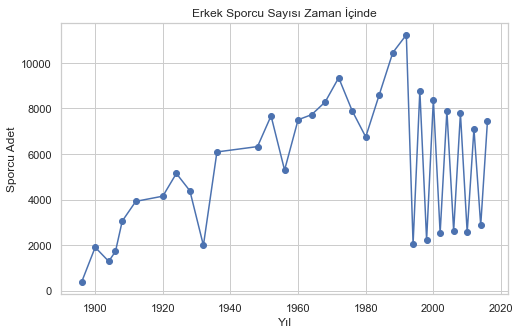

In [62]:
plt.figure(figsize=(8, 5))  # Grafik boyutu
plt.plot(Erkek_sporcu_sayisi['Yıl'], Erkek_sporcu_sayisi['Sporcu Adet'], marker='o', linestyle='-', color='b')
plt.title('Erkek Sporcu Sayısı Zaman İçinde')
plt.xlabel('Yıl')
plt.ylabel('Sporcu Adet')
plt.grid(True)
plt.show()

In [63]:
# Kadınlar

In [64]:
# 'data_new_F' DataFrame'ini yıl bazında gruplayarak sporcu sayısını hesaplama
sporcu_sayisi_F = data_new_F.groupby('Year')['Medal'].count()

# Yeni oluşturulan verileri içeren DataFrame
Kadın_sporcu_sayisi = pd.DataFrame(sporcu_sayisi_F)
Kadın_sporcu_sayisi = sporcu_sayisi_F.reset_index()  # Index sütununu sıfırla
Kadın_sporcu_sayisi.columns = ['Yıl', 'Sporcu Adet']  # Sütun adlarını değiştirme

In [65]:
Kadın_sporcu_sayisi.head()

,Yıl,Sporcu Adet
0,1900,33
1,1904,16
2,1906,11
3,1908,47
4,1912,87


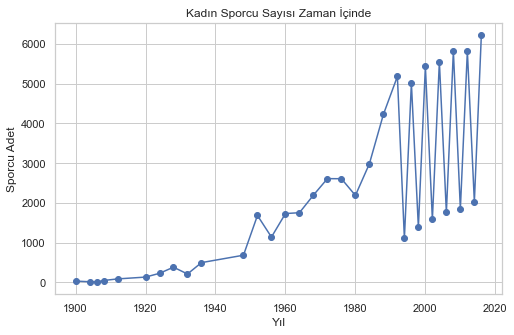

In [66]:
plt.figure(figsize=(8, 5))  # Grafik boyutu
plt.plot(Kadın_sporcu_sayisi['Yıl'], Kadın_sporcu_sayisi['Sporcu Adet'], marker='o', linestyle='-', color='b')
plt.title('Kadın Sporcu Sayısı Zaman İçinde')
plt.xlabel('Yıl')
plt.ylabel('Sporcu Adet')
plt.grid(True)
plt.show()

## 4. Modelleme

### ARİMA ile Zaman serisi analizi

#### Erkek Sporcular

In [69]:
# En iyi ARIMA Modelinin Bulunması
stepwise_fit = auto_arima(Erkek_sporcu_sayisi['Sporcu Adet'], trace=True,
suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=645.258, Time=0.44 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=661.916, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=663.023, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=665.133, Time=0.02 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=713.153, Time=0.01 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=653.468, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=642.978, Time=0.03 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=665.884, Time=0.02 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=644.049, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=644.688, Time=0.06 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=645.671, Time=0.04 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=646.770, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=644.674, Time=0.03 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0] intercept
Total fit time: 1.081 seconds


In [70]:
#Test - Trainset Ayırma 
#'Yıl' sütununu indeks olmaktan çıkar.
Erkek_sporcu_sayisi.reset_index(inplace=True)

#Yıl sütununu tekrar sayısal bir sütun haline getirme
Erkek_sporcu_sayisi['Yıl'] = Erkek_sporcu_sayisi['Yıl'].astype(int)

#Test - Trainset oluşturma
M_train_data = Erkek_sporcu_sayisi.loc[(Erkek_sporcu_sayisi['Yıl'] >= 1896) & (Erkek_sporcu_sayisi['Yıl'] <= 2002)]
M_test_data = Erkek_sporcu_sayisi.loc[(Erkek_sporcu_sayisi['Yıl'] >= 2004) & (Erkek_sporcu_sayisi['Yıl'] <= 2016)]

In [71]:
# Modeli oluşturma ve eğitme
model = ARIMA(M_train_data['Sporcu Adet'], order=(2, 0, 1))
model_fit = model.fit()

# Tahmin yapma
start_index = len(M_train_data)
end_index = len(M_train_data) + len(M_test_data) - 1
predictions = model_fit.predict(start=start_index, end=end_index)

# Gerçek değerler
real_values = M_test_data['Sporcu Adet']

# RMSE hesaplama
rmse = np.sqrt(mean_squared_error(real_values, predictions))
print(f"RMSE: {rmse}")

RMSE: 972.5667506860432


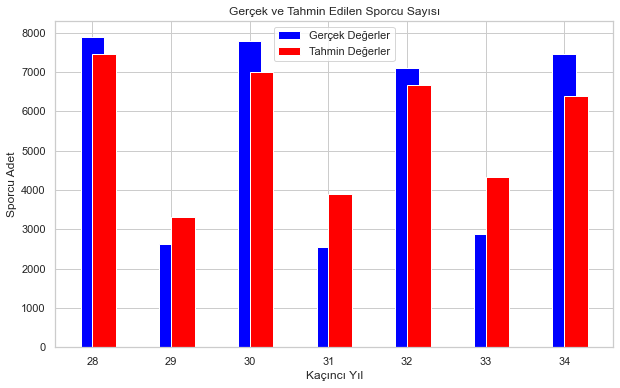

In [72]:
# Çubuk grafik çizme
plt.figure(figsize=(10, 6))

plt.bar(M_test_data.index, real_values, width=0.3, align='center', label='Gerçek Değerler', color='blue')
plt.bar(M_test_data.index, predictions, width=0.3, align='edge', label='Tahmin Değerler', color='red')

plt.xlabel('Kaçıncı Yıl')
plt.ylabel('Sporcu Adet')
plt.title('Gerçek ve Tahmin Edilen Sporcu Sayısı')
plt.legend()
plt.show()

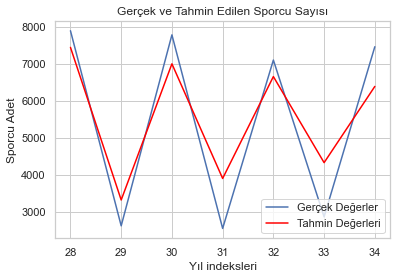

In [73]:
plt.plot(M_test_data.index, M_test_data['Sporcu Adet'], label='Gerçek Değerler')
plt.plot(M_test_data.index, predictions, color='red', label='Tahmin Değerleri')
plt.xlabel('Yıl indeksleri')
plt.ylabel('Sporcu Adet')
plt.title('Gerçek ve Tahmin Edilen Sporcu Sayısı')
plt.legend()
plt.show()

In [74]:
# Modelin tahminlemesi
future_predictions = model_fit.forecast(steps=16)  # Gelecek 16 adet tahmin

# Elde edilen tahminlerin değerlerini gösterme
print(f"Gelecek Tahminler: {future_predictions}")

Gelecek Tahminler: 28    7447.273425
29    3323.318624
30    7003.098779
31    3905.488264
32    6658.328886
33    4332.300094
34    6392.219978
35    4646.012742
36    6187.767382
37    4877.126899
38    6031.279737
39    5047.741812
40    5911.880758
41    5173.926784
42    5821.019506
43    5267.404990
Name: predicted_mean, dtype: float64


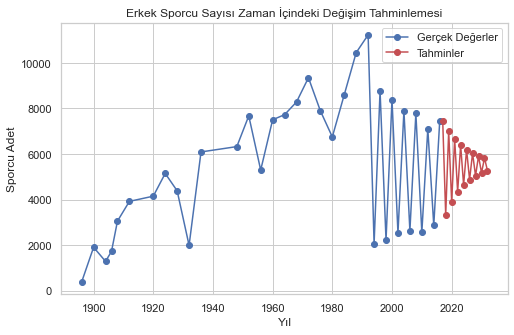

In [75]:
# Gerçek verilerin çizimi
plt.figure(figsize=(8, 5))
plt.plot(Erkek_sporcu_sayisi['Yıl'], Erkek_sporcu_sayisi['Sporcu Adet'], marker='o', linestyle='-', color='b', label='Gerçek Değerler')

# Tahminlerin çizimi
predicted_years = range(Erkek_sporcu_sayisi['Yıl'].max() + 1, Erkek_sporcu_sayisi['Yıl'].max() + 1 + 16)  # Gelecek yılların listesi
plt.plot(predicted_years, future_predictions, marker='o', linestyle='-', color='r', label='Tahminler')

# Grafik ayarları
plt.title('Erkek Sporcu Sayısı Zaman İçindeki Değişim Tahminlemesi')
plt.xlabel('Yıl')
plt.ylabel('Sporcu Adet')
plt.legend()
plt.grid(True)
plt.show()


#### Kadın Sporcular;

In [77]:
# En iyi ARIMA Modelinin Bulunması
stepwise_fit = auto_arima(Kadın_sporcu_sayisi['Sporcu Adet'], trace=True,
suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=545.953, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=611.416, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=541.526, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.08 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=609.617, Time=0.01 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=543.460, Time=0.03 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=542.906, Time=0.07 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=545.282, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=542.560, Time=0.02 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0] intercept
Total fit time: 0.573 seconds


In [78]:
#Test - Trainset Ayırma 
#'Yıl' sütununu indeks olmaktan çıkardım
Kadın_sporcu_sayisi.reset_index(inplace=True)

#Yıl sütununu tekrar sayısal bir sütun haline getirdim
Kadın_sporcu_sayisi['Yıl'] = Kadın_sporcu_sayisi['Yıl'].astype(int)

#Test - Trainset oluşturdum
F_train_data = Kadın_sporcu_sayisi.loc[(Kadın_sporcu_sayisi['Yıl'] >= 1896) & (Kadın_sporcu_sayisi['Yıl'] <= 2002)]
F_test_data = Kadın_sporcu_sayisi.loc[(Kadın_sporcu_sayisi['Yıl'] >= 2004) & (Kadın_sporcu_sayisi['Yıl'] <= 2016)]

In [79]:
# Modeli oluşturma ve eğitme
model = ARIMA(F_train_data['Sporcu Adet'], order=(1, 1, 0))
model_fit = model.fit()

# Tahmin yapma
start_index = len(F_train_data)
end_index = len(F_train_data) + len(F_test_data) - 1
predictions = model_fit.predict(start=start_index, end=end_index)

# Gerçek değerler
real_values = F_test_data['Sporcu Adet']

# RMSE hesaplama
rmse = np.sqrt(mean_squared_error(real_values, predictions))
print(f"RMSE: {rmse}")

RMSE: 855.200155103033


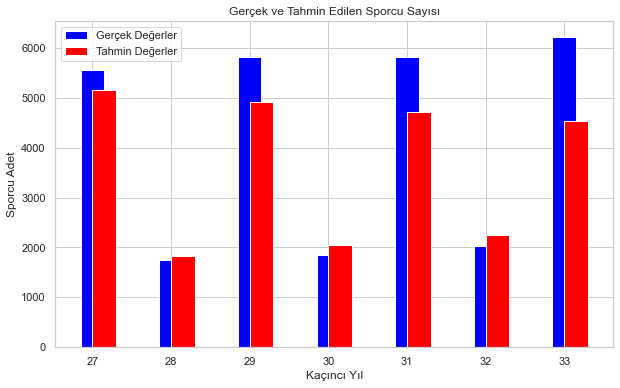

In [80]:
# Çubuk grafik 
plt.figure(figsize=(10, 6))

plt.bar(F_test_data.index, real_values, width=0.3, align='center', label='Gerçek Değerler', color='blue')
plt.bar(F_test_data.index, predictions, width=0.3, align='edge', label='Tahmin Değerler', color='red')

plt.xlabel('Kaçıncı Yıl')
plt.ylabel('Sporcu Adet')
plt.title('Gerçek ve Tahmin Edilen Sporcu Sayısı')
plt.legend()
plt.show()

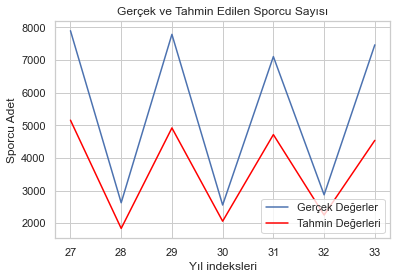

In [81]:
plt.plot(F_test_data.index, M_test_data['Sporcu Adet'], label='Gerçek Değerler')
plt.plot(F_test_data.index, predictions, color='red', label='Tahmin Değerleri')
plt.xlabel('Yıl indeksleri')
plt.ylabel('Sporcu Adet')
plt.title('Gerçek ve Tahmin Edilen Sporcu Sayısı')
plt.legend()
plt.show()

In [82]:
# Modelin tahminlemesi
future_predictions = model_fit.forecast(steps=16)  # Gelecek 16 adet tahmin

# Elde edilen tahminlerin değerlerini gösterme
print(f"Gelecek Tahminler: {future_predictions}")

Gelecek Tahminler: 27    5155.385820
28    1837.878359
29    4917.830065
30    2058.423530
31    4713.077406
32    2248.514528
33    4536.598196
34    2412.356644
35    4384.488273
36    2553.574478
37    4253.382582
38    2675.292123
39    4140.380736
40    2780.202281
41    4042.982848
42    2870.625827
Name: predicted_mean, dtype: float64


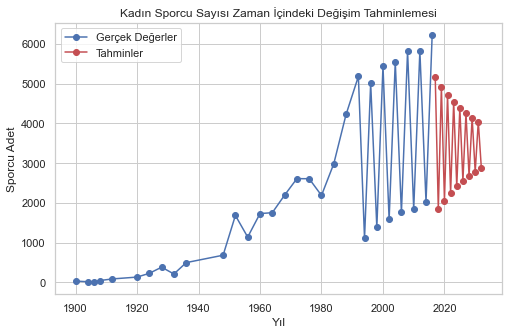

In [83]:
# Gerçek verilerin çizimi
plt.figure(figsize=(8, 5))
plt.plot(Kadın_sporcu_sayisi['Yıl'], Kadın_sporcu_sayisi['Sporcu Adet'], marker='o', linestyle='-', color='b', label='Gerçek Değerler')

# Tahminlerin çizimi
predicted_years = range(Kadın_sporcu_sayisi['Yıl'].max() + 1, Kadın_sporcu_sayisi['Yıl'].max() + 1 + 16)  # Gelecek yılların listesi
plt.plot(predicted_years, future_predictions, marker='o', linestyle='-', color='r', label='Tahminler')

# Grafik ayarları
plt.title('Kadın Sporcu Sayısı Zaman İçindeki Değişim Tahminlemesi')
plt.xlabel('Yıl')
plt.ylabel('Sporcu Adet')
plt.legend()
plt.grid(True)
plt.show()
